In [1]:
import sympy as sp
import numpy as np
from scipy.integrate import quad
from scipy.stats import norm
import matplotlib.pyplot as plt
from sympy.utilities import lambdify
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [2]:
sp.init_printing()

In [3]:
x = sp.Symbol('x', real=True)
k = sp.Symbol('k', real=True, positive=True)
a = sp.Symbol('a', real=True)
m = sp.Symbol('m', real=True, positive=True)
t = sp.Symbol('t', real=True, positive=True)
h = sp.Symbol('hbar', real=True, positive=True)
n = sp.Symbol('n', integer=True, nonzero=True)
psi = sp.Function('psi')

x, k, a, m, t, h, n, psi(x)

$$\frac{d^2\psi(x)}{dx^2} = -k^2\psi(x)$$

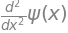

In [4]:
psi(x).diff(x, x)

In [5]:
-k**2 * psi(x)

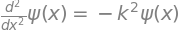

In [6]:
eq = sp.Eq(psi(x).diff(x, x), -k**2 * psi(x))
eq

In [7]:
sp.dsolve(eq, psi(x))

In [8]:
sp.dsolve(eq, psi(x), ics={psi(0): 0, psi(a): 0})

In [9]:
sol = sp.dsolve(eq, psi(x), ics={psi(0): 0})
sol

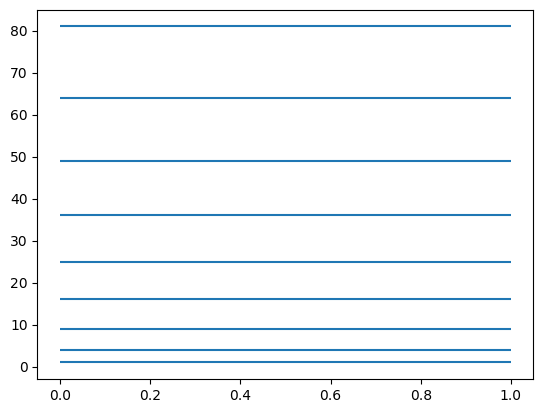

In [10]:
plt.hlines(np.arange(1, 10)**2, 0, 1)

In [11]:
sol = sol.subs(k, n * sp.pi / a)
sol

In [12]:
sol.lhs, sol.rhs

In [13]:
sp.Abs(sol.rhs)**2

In [14]:
sp.integrate(sol.rhs**2, (x, 0, a))

In [15]:
sol = sol.subs(sp.Symbol('C1'), sp.sqrt(2 / a))
sol

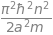

In [16]:
En = n**2 * sp.pi**2 * h**2 / (2 * m * a**2)
En

In [17]:
phi = sp.exp(-sp.I * En * t / h)
phi

In [18]:
Psi = sol.rhs * phi
Psi

In [19]:
Psif = lambdify((x, t, n), Psi.subs({a: 1, m: 1, h: 1}))
Psif

<function _lambdifygenerated(x, t, n)>

In [20]:
Psif(0.3, 2.3, 1)

(0.3971182633717983+1.0729930471683005j)

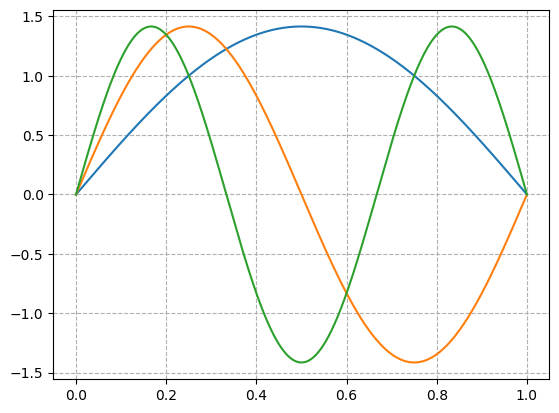

In [21]:
xs = np.linspace(0, 1, 1000)

plt.grid(linestyle='--')

ys = Psif(xs, 0, 1).real
plt.plot(xs, ys)

ys = Psif(xs, 0, 2).real
plt.plot(xs, ys)

ys = Psif(xs, 0, 3).real
plt.plot(xs, ys)

In [25]:
n = 5

xs = np.linspace(0, 1, 1000)

fig = plt.figure()

plt.xlim(0, 1)
plt.ylim(-1.5, 1.5)

plot1, = plt.plot([], [])
plot2, = plt.plot([], [])

plt.close()

dt = 0.001

def frame(i):
    ys = Psif(xs, i * dt, n)

    plot1.set_data(xs, ys.real)
    plot2.set_data(xs, ys.imag)

    return plot1, plot2

anim = FuncAnimation(fig, frame, frames=300, interval=20, blit=True)
HTML(anim.to_jshtml())

In [26]:
n = 2

xs = np.linspace(0, 1, 1000)

fig = plt.figure()

plt.xlim(0, 1)
plt.ylim(0, 3)

plot1, = plt.plot([], [])


plt.close()

dt = 0.001

def frame(i):
    ys = Psif(xs, i * dt, n)

    plot1.set_data(xs, np.abs(ys)**2)

    return plot1,

anim = FuncAnimation(fig, frame, frames=300, interval=20, blit=True)
HTML(anim.to_jshtml())

In [27]:
xs = np.linspace(0, 1, 1000)

fig = plt.figure()

plt.xlim(0, 1)
plt.ylim(0, 4)

plot1, = plt.plot([], [])


plt.close()

dt = 0.001

def frame(i):
    ys = (1 * Psif(xs, i * dt, 1) + 1 * Psif(xs, i * dt, 2) + Psif(xs, i * dt, 3) + Psif(xs, i * dt, 4)) / np.sqrt(1**2 + 1**2 + 1**2 + 1**2)

    plot1.set_data(xs, np.abs(ys)**2)

    return plot1,

anim = FuncAnimation(fig, frame, frames=600, interval=20, blit=True)
HTML(anim.to_jshtml())

$$<\omega>=\int \Psi^{*} \hat{\omega} \Psi\ dx$$
W stanie stacjonarnym
$$<\omega>=\int \psi^{*} \hat{\omega} \psi\ dx$$

$$\hat{x}=x$$

In [28]:
sol.rhs * x * sol.rhs

In [29]:
sp.integrate(sol.rhs * x * sol.rhs, (x, 0, a)).simplify()

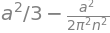

In [30]:
sp.integrate(sol.rhs * x**2 * sol.rhs, (x, 0, a)).simplify()

$$\sigma_X^2=<x^2>-<x>^2$$

$$<p>=?$$
$$<p^2>=?$$
$$\sigma_P^2=?$$

$$\sigma_X \sigma_P \geq \frac{\hbar}{2}$$

Spradzić, czy ta zasada nieoznaczoności jest faktycznie dla tej studni potencjału spełniona.

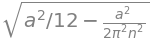

In [69]:
# Obliczanie odchylenia standardowego x
sigma_x = sp.sqrt(sp.simplify(sp.integrate(sol.rhs * x**2 * sol.rhs, (x, 0, a))) - sp.simplify(sp.integrate(sol.rhs * x * sol.rhs, (x, 0, a))**2))
sigma_x

In [70]:
# Obliczanie średniej p
p = sp.simplify(sp.integrate(sol.rhs*(-sp.I * h * sp.diff(sol.rhs, x)), (x, 0, a)))
p

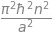

In [52]:
# Obliczanie średniej p^2
p_square = sp.simplify(sp.integrate(sol.rhs*(sp.I**2 * h**2 * sp.diff(sol.rhs, x, 2)), (x, 0, a)))
p_square

In [53]:
# Obliczanie odchylenia standardowego p
sigma_p = sp.simplify(sp.sqrt(p_square-p**2))
sigma_p

In [57]:
# Iloczyn odchyleń standardowych
sigma_il = sp.simplify(sigma_x * sigma_p)
sigma_il

In [63]:
# Nierówność Heisenberga
h_nier = ((sigma_il - h/2) >= 0)
h_nier

In [75]:
# Sprawdzenie
h_exp = sp.simplify(sigma_il.subs(n, 1) - h/2)
h_wynik = sp.simplify(h_exp.evalf())
h_wynik